In [9]:
from src.LatentSpace import LatentSpace
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
import pandas as pd
import umap
import tqdm as notebook_tqdm
from sklearn.cluster import KMeans
import seaborn as sns
import umap.plot
from sklearn.cluster import MiniBatchKMeans
from pyarrow import feather

In [2]:
latent_space = LatentSpace(autoencoder_path='data/autoencoder_256dim_time_freq_128k_simplified_25e',
                        image_dir='data/Spotify/comp_pngs/',
                        tracks_feather_path='data/all_tracks.feather',
                        latent_dims=256,
                        threshold_level=0.5
                        )

Found 278581 files for Generator set


In [3]:
latent_space.load('data/autoencoder_256dim_time_freq_128k_simplified_25e/')

Loaded tracks.
Loaded artists.
Loaded genres.


In [4]:
data = latent_space.tracks[latent_space.latent_cols]

In [5]:
data

,latent_0,latent_1,latent_2,latent_3,latent_4,latent_5,latent_6,latent_7,latent_8,latent_9,...,latent_246,latent_247,latent_248,latent_249,latent_250,latent_251,latent_252,latent_253,latent_254,latent_255
0,-0.316162,-0.341385,-0.636953,1.528115,0.290868,0.270023,0.396002,-1.534920,-1.737897,0.525925,...,0.468056,0.572739,0.509286,-0.114769,-1.122558,-0.123341,0.416501,0.155566,-0.038465,0.452529
1,0.676192,-1.640926,-0.861211,0.319794,-0.636246,0.921979,-0.370586,1.078572,-0.473801,0.345206,...,-0.634910,-1.212548,-0.340947,1.226729,1.165256,-1.038659,-1.289343,-0.896680,0.628686,-0.146293
2,0.402572,-1.290611,-0.642024,0.317626,0.081170,-1.155909,0.737570,1.154860,0.771713,1.155484,...,-1.356902,-0.756416,-1.854302,0.895497,1.303428,0.274343,-1.692989,-0.819847,2.048947,-0.438281
3,-1.075822,0.109207,-0.737722,1.257008,-1.688226,0.756683,0.864221,0.374334,-2.165439,-0.302369,...,0.610143,1.484256,1.976590,-0.604750,-1.800446,-0.324299,1.808718,1.125488,-2.009448,-2.640264
4,0.739382,0.886494,0.504282,1.017155,-0.015817,0.757656,0.938300,0.055938,-1.012184,-0.592651,...,-0.118683,0.198598,0.190540,-0.172247,-0.245514,-1.231224,0.467299,-0.002855,-0.760122,-0.652592
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278576,0.479462,0.477101,0.187210,1.287060,-0.686032,0.778330,1.636855,0.124938,-1.054396,-0.131554,...,-0.448271,0.626960,0.194494,-0.373252,0.553188,-1.014149,-0.549733,-0.184954,0.855292,-0.267781
278577,2.389702,-1.171095,-0.968906,-1.286882,-1.431882,-0.757207,-1.127045,0.775129,0.368699,1.470648,...,1.522607,0.774641,1.701041,-0.199105,-0.170360,0.168011,1.055279,0.128093,-1.334521,0.184026
278578,0.263703,0.004525,1.374635,1.042592,0.351790,-0.176806,0.598302,-0.151109,0.605744,-0.005813,...,0.898361,0.647242,0.850167,-1.121904,-0.713517,1.417979,0.557151,1.141494,-0.778010,0.391542
278579,-1.095162,-0.132068,-0.169236,-0.637185,0.637972,-0.518894,0.761820,0.349537,0.327421,-0.348692,...,0.413772,-0.668619,0.236673,-0.051788,0.691895,-0.071044,-0.408926,-0.031922,0.098103,1.292462


In [6]:
embedding = umap.UMAP(n_neighbors=500, min_dist=.5).fit_transform(data)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


<IPython.core.display.Javascript object>


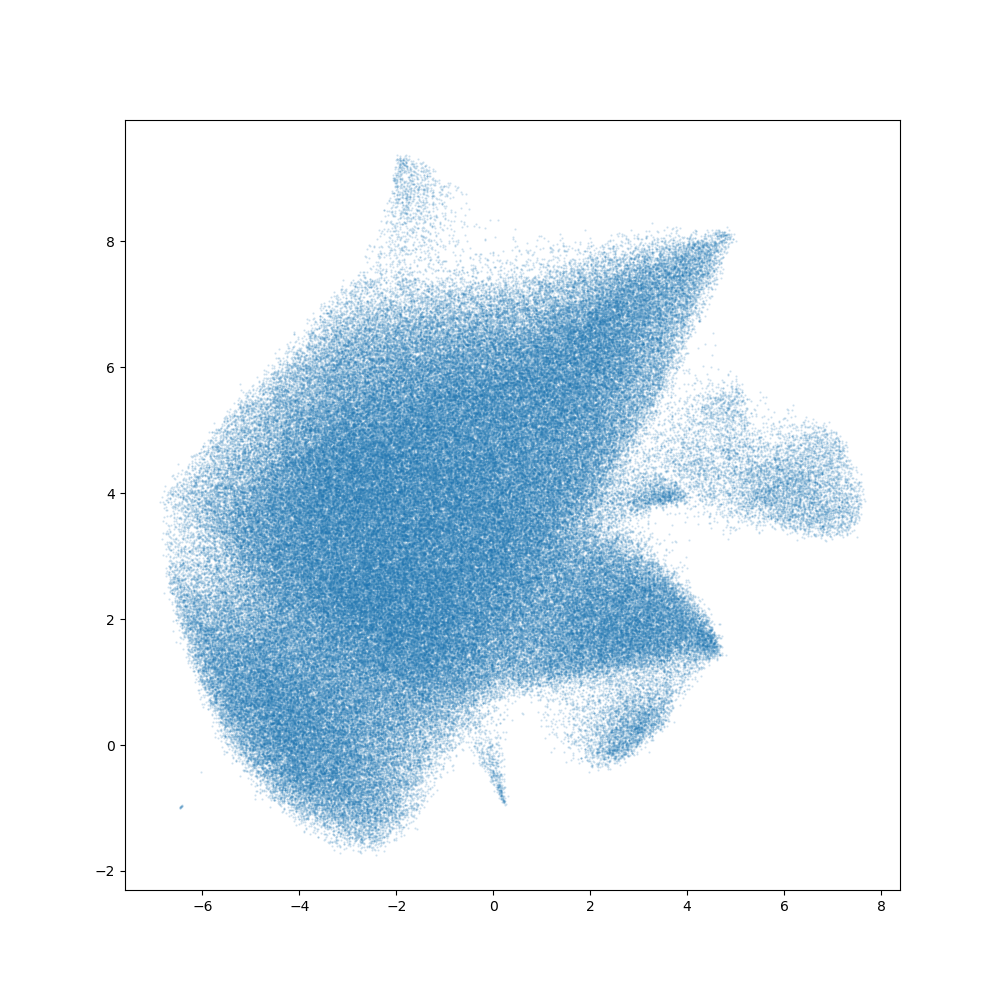

In [43]:
fig, ax = plt.subplots(1, figsize=(10, 10))
plt.scatter(*embedding.T, s=0.3, alpha=.2)

/Users/michaelroth/miniforge3/envs/golden_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


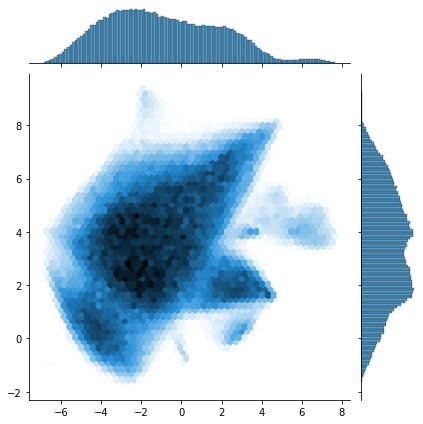

In [8]:
sns.jointplot(*embedding.T, kind='hex')

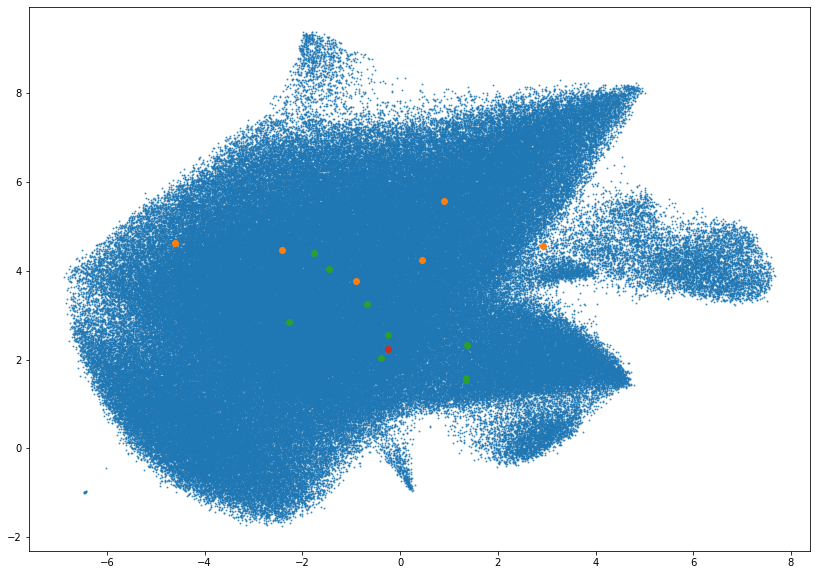

In [9]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding.T, s=1, alpha=.7)
plt.scatter(*embedding[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding[latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')['index']].T)
plt.scatter(*embedding[257270].T)
plt.show()

In [10]:
embedding_time = umap.UMAP(n_neighbors=500, min_dist=.5).fit_transform(data[latent_space.latent_cols[:128]])

In [11]:
embedding_freq = umap.UMAP(n_neighbors=500, min_dist=.5).fit_transform(data[latent_space.latent_cols[128:]])

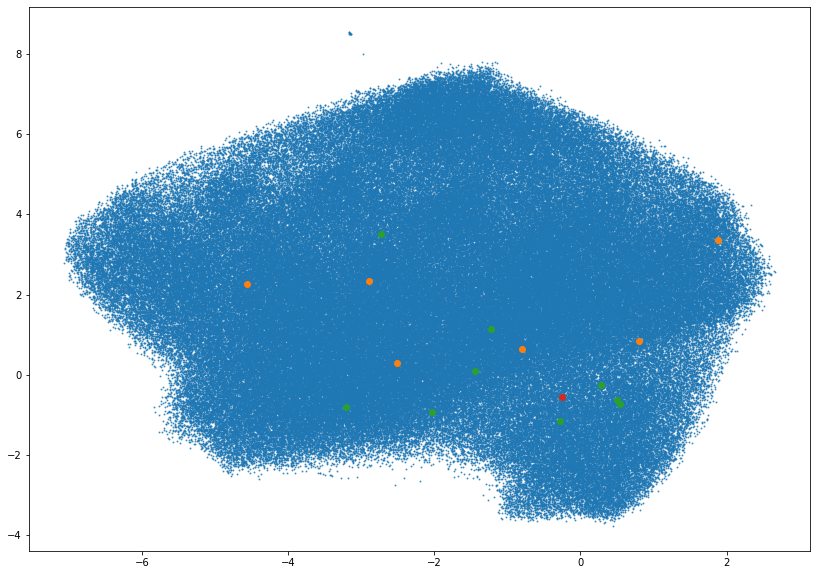

In [12]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding_time.T, s=1, alpha=.7)
plt.scatter(*embedding_time[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding_time[latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')['index']].T)
plt.scatter(*embedding_time[257270].T)
plt.show()

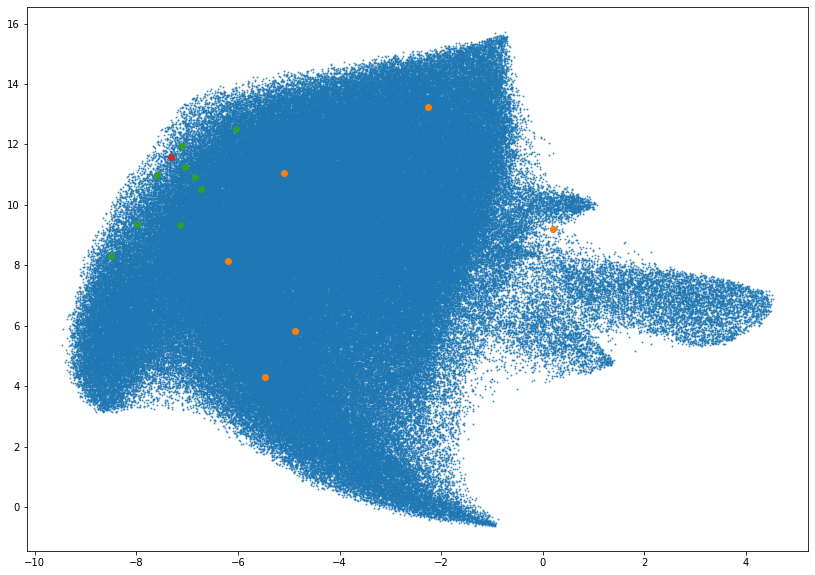

In [13]:
fig, ax = plt.subplots(1, figsize=(14, 10))
plt.scatter(*embedding_freq.T, s=1, alpha=.7)
plt.scatter(*embedding_freq[latent_space.get_index_by_artist_name('Kraftwerk').index].T)
plt.scatter(*embedding_freq[latent_space.get_similar_tracks_by_index(257270)['index']].T)
plt.scatter(*embedding_freq[257270].T)
plt.show()

In [14]:
latent_space.get_index_by_artist_name('Kraftwerk')

,track_id,track_name,artist_name
133220,48Q7pVDuBivnR5rdf6RGYT,Spacelab - 2009 Remaster,Kraftwerk
139696,7CZdd0S4WTktuiiARS8pY4,Computer Love - 2009 Remaster,Kraftwerk
209416,5eqZWYQ5tbIehx00NeKXz7,The Robots - 2009 Remaster,Kraftwerk
211814,6bDRVbdZEyBnmOX0Yjh5rf,Pocket Calculator - 2009 Remaster,Kraftwerk
218191,31uidLEHAcF8Cw1cX1VCS8,Autobahn - 2009 Remaster,Kraftwerk
224855,3VwLD5o1r0YBLkjUfgSEYg,Das Model,Kraftwerk


In [15]:
latent_space.get_similar_tracks_by_index(257270, similarity_measure='cosine')

,index,track_name,artist_name,track_uri,similarity
0,257270,Medication (Merriweather Bradley),Sonny Smith,spotify:track:6Twum7gr6q90jnYYkSnzjW,1.000000
1,242991,Let Me Be Sweet to You,Motel Mirrors,spotify:track:1Jnhw5JXWPbDF4rm7jHNhv,0.710494
2,195033,Suzanne,Leonard Cohen,spotify:track:2L93TdW2GMue1H2zlkt30F,0.710058
3,118556,This Is In Your Heart,Iskelu,spotify:track:0PCvGiPOOOwrS1T4gG3RFX,0.708623
4,15771,Untitled Interlude I,Chris Herbert,spotify:track:5Y9e6vfQgV6zjMUpTmP1iF,0.701378
5,244439,Licht,yoshinori takezawa,spotify:track:1fpkYiQ0Qj53cPqfCOM9EK,0.699912
6,53482,Longing for the Day,Ken Bonfield,spotify:track:0lGPEA8886LT6aWn84LI6D,0.693046
7,53812,Star Shepherd,Corciolli,spotify:track:47BFvqd7NVviRxLuDQwHvX,0.692509
8,42015,Don't Look Back in Anger,Jay Nash,spotify:track:6Dx8zkR2v25WwtOoKzecmM,0.687941
9,128520,Ye Banks And Braes O' Bonnie Doon,Alasdair Roberts,spotify:track:3pDrl6VzzbbcYJvSsRTzX8,0.683580


In [16]:
from sklearn.metrics.pairwise import cosine_similarity

seed_index = 125661

similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols]], latent_space.tracks[latent_space.latent_cols])

time_similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols[:128]]], latent_space.tracks[latent_space.latent_cols[:128]])

freq_similarities = cosine_similarity([latent_space.tracks.iloc[seed_index][latent_space.latent_cols[128:]]], latent_space.tracks[latent_space.latent_cols[128:]])

similarities_df = latent_space.tracks.copy()

similarities_df['similarity'] = similarities.T
similarities_df['time_similarity'] = time_similarities.T
similarities_df['freq_similarity'] = freq_similarities.T

similarities_df.sort_values(by='similarity', ascending=False).reset_index()[:10][['index','track_uri','track_name','artist_name','similarity','time_similarity','freq_similarity']]


,index,track_uri,track_name,artist_name,similarity,time_similarity,freq_similarity
0,125661,spotify:track:1MC3nPuchNlSMZqm9iQftq,Assimilate,Malaise,1.000000,1.000000,1.000000
1,125508,spotify:track:3OeO5BFbIgTuibgMcMzr6g,Redemption,The Fullblast,0.697299,0.655238,0.814408
2,171683,spotify:track:12YMpJ6CobclbD1JsWyska,Sway - Live,Mick Taylor,0.696176,0.693864,0.727994
3,150228,spotify:track:1rSEO7xVyUx880dslohvlQ,夜空になりたくて,kobore,0.690570,0.685368,0.705903
4,113641,spotify:track:1nR8lEGXXd7lKWzXqptUjJ,Maxとき315号,NGT48,0.683722,0.730648,0.585545
5,65184,spotify:track:7cNyONpVADZVrW9xe3qq4z,Heroes of Sand,ANGRA,0.678714,0.632015,0.818371
6,169492,spotify:track:4xAxbQhYpzkphA0KvNm78P,Stop Killing Me,The Primitives,0.678653,0.675197,0.693348
7,213384,spotify:track:2Y2fyI7ydrdq9ISJyffcJQ,Permanent Heartbreak,The Friday Night Boys,0.676892,0.700741,0.629955
8,93493,spotify:track:5uyf6PKOB2AqtkKMOjsjkv,Goodbye,Goodness,0.674875,0.626427,0.787021
9,82897,spotify:track:152yLjLT2T0W8kf2hutvo1,Out of My Way,Onlap,0.667847,0.634952,0.732887


In [10]:
genre_seeds = feather.read_feather('data/genre_seeds.feather')

In [22]:
genre_seeds.genre[120:]

120         techno
121         trance
122       trip-hop
123        turkish
124       work-out
125    world-music
Name: genre, dtype: object

In [79]:
latent_space.genres[latent_space.genres.index.str.contains('blues')][:60]

,latent_0,latent_1,latent_2,latent_3,latent_4,latent_5,latent_6,latent_7,latent_8,latent_9,...,latent_246,latent_247,latent_248,latent_249,latent_250,latent_251,latent_252,latent_253,latent_254,latent_255
genre,,,,,,,,,,,,,,,,,,,,,
acoustic blues,-0.280783,-0.007332,0.006376,-0.212260,0.386848,0.427027,-1.271316,-1.000140,0.267400,-0.279657,...,0.749720,0.500884,0.137432,-0.329311,-0.145706,0.488642,-0.203492,0.610442,0.094462,0.560826
australian blues,-0.041787,0.408017,-0.220887,-0.866629,-0.442211,-0.064780,0.090776,0.243274,0.145194,-0.592297,...,-0.074673,-0.430201,-0.146785,0.102987,0.247873,0.174938,-0.200896,-0.168669,0.270102,0.156496
blues rock,0.219634,-0.754940,-0.469363,-0.550379,-1.046567,0.559581,0.030578,0.849619,0.785696,0.088536,...,-0.481483,-0.582098,-0.312786,0.537565,0.452796,-0.246079,-0.190040,-0.427038,0.287198,-0.071159
brazilian blues,-0.080704,-0.889171,0.153584,-0.760513,0.125556,0.028259,0.121346,-0.045999,0.961034,0.442203,...,-0.038140,0.046432,-0.489805,-0.018090,0.140877,0.396568,-0.374938,0.040143,0.356993,-0.033541
british blues,0.311744,-0.053613,0.232351,-0.616142,-0.055088,0.062992,-0.503801,0.222153,0.264323,0.549334,...,-0.077686,-0.326785,-0.180606,0.126643,-0.013110,0.097430,0.021848,-0.180798,0.011292,-0.138071
classic female blues,-1.887429,1.477401,0.076422,0.499499,0.706065,0.561340,-0.660050,-2.367276,-1.617727,-0.958582,...,0.420594,0.929942,0.732022,0.148297,-1.458202,-0.410054,-0.213072,0.111482,-0.363799,-0.561892
dutch blues,-0.178066,0.042408,0.186327,-0.424939,0.233033,-0.481235,-0.657356,-0.517673,0.069137,0.600571,...,0.009645,-0.160230,-0.262297,-0.128903,-0.145728,0.316920,-0.120874,0.168301,0.183388,0.122124
electric blues,-0.051424,-0.006762,0.177974,-0.698676,-0.162366,-0.178257,0.031883,0.318846,0.452278,0.154030,...,-0.372469,-0.708741,-0.316469,0.437432,0.160014,-0.274198,-0.188763,-0.366924,0.308881,0.410918
finnish blues,0.909140,0.412472,0.421962,-1.582293,0.795339,-0.668001,1.028041,-0.117451,1.462361,0.115016,...,-1.077305,-1.498366,-0.750314,0.485486,-0.975082,-0.831449,0.685494,-1.998737,0.140184,0.813152


In [90]:
base_genres = ['alternative rock',
               'ambient',
               'traditional blues',
               'classical performance',
               'country',
               'dancehall',
               'disco',
               'drum and bass',
              'funk',
              'hip hop',
              'house',
              'indie pop',
              'jazz',
              'metal',
              'pop',
              'punk',
              'r&b',
              'reggae',
              'rock',
              'salsa',
              'ska',
              'soul',
              'techno']

In [24]:
genre_map = umap.UMAP(n_neighbors=100, min_dist=.1).fit(latent_space.genres[latent_space.latent_cols])
genre_hover_data = pd.DataFrame(latent_space.genres.index)
umap.plot.output_notebook()
p = umap.plot.interactive(genre_map, point_size=10, hover_data=genre_hover_data)
umap.plot.show(p)

Loading BokehJS ...

In [138]:
artist_tracks.id

77626     2j3PFZXmenUxgjjBUIod7F
113682    2PN0JeaGtkHrlcmwZFWzBM
174933    29imR7dda5XqwPRFmby7HS
225318    2HZGsnMByx3V8KmNW6LqWF
268223    5NoQvINZLBV1wMYPdNmReL
Name: id, dtype: object

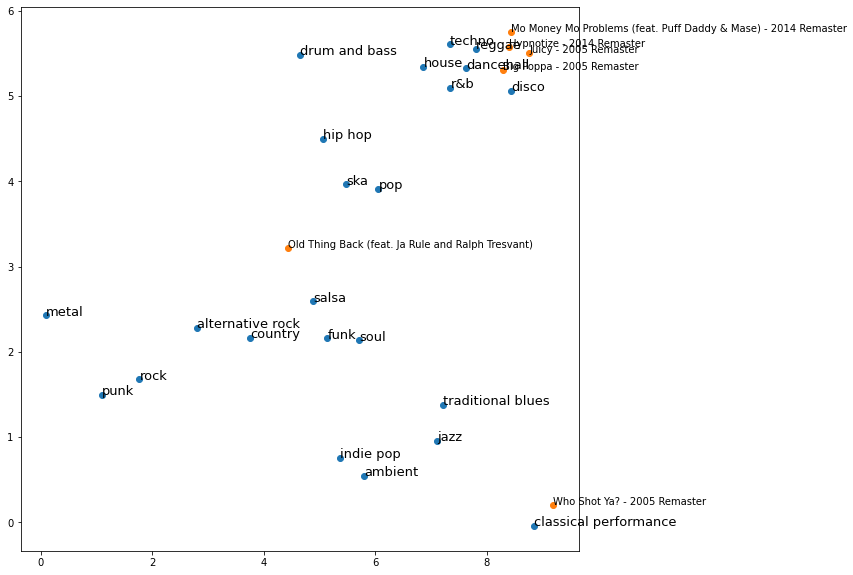

In [151]:
artist_name = 'Notorious B.I.G'
artist_tracks = latent_space.tracks.iloc[latent_space.get_index_by_artist_name(artist_name).index]
artist_pts = genre_map.transform(artist_tracks[latent_space.latent_cols])

genre_embedding = genre_map.transform(latent_space.genres[latent_space.latent_cols])

plt.figure(figsize=(10,10))
plt.scatter(*genre_embedding[latent_space.genres.reset_index().genre.isin(base_genres)].T)
for genre in base_genres:
    plt.annotate(genre, genre_embedding[latent_space.genres.reset_index().genre.isin([genre])].reshape(-1), size=13)
    
plt.scatter(*artist_pts.T)
for idx, track in artist_tracks.iterrows():
    plt.annotate(track.track_name, artist_pts[track.id == artist_tracks.id].reshape(-1))

/Users/michaelroth/miniforge3/envs/golden_env/lib/python3.9/site-packages/umap/plot.py:203: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_nhood_compare" failed type inference due to: No implementation of function Function(<function hstack at 0x109549280>) found for signature:
 
 >>> hstack(list(array(int32, 1d, C))<iv=None>)
 
There are 4 candidate implementations:
  - Of which 4 did not match due to:
  Overload in function '_OverloadWrapper._build.<locals>.ol_generated': File: numba/core/overload_glue.py: Line 131.
    With argument(s): '(list(array(int32, 1d, C))<iv=None>)':
   Rejected as the implementation raised a specific error:
     TypingError: Failed in nopython mode pipeline (step: nopython frontend)
   No implementation of function Function(<intrinsic stub>) found for signature:
    
    >>> stub(list(array(int32, 1d, C))<iv=None>)
    
   There are 2 candidate implementations:
     - Of which 2 did not match due to:
  

<AxesSubplot:title={'center':'Colored by neighborhood Jaccard index'}>

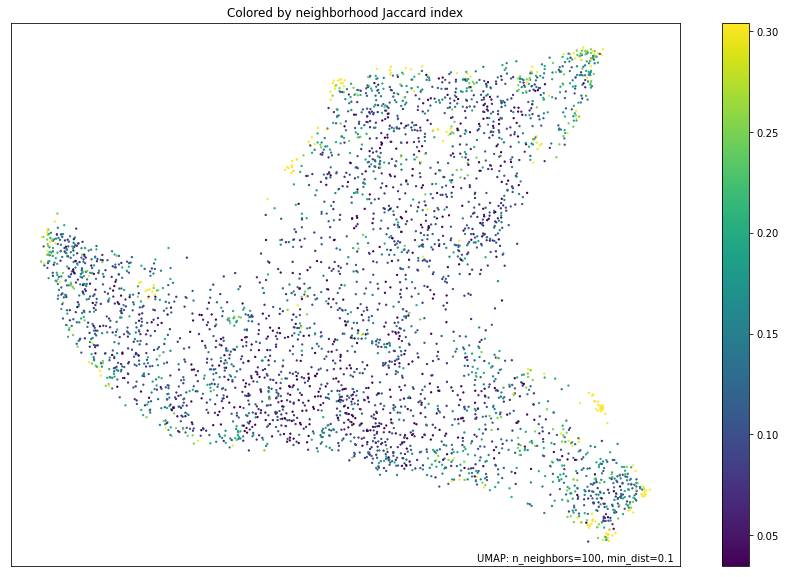

In [18]:
fig, ax = plt.subplots(figsize=(15,10))
umap.plot.diagnostic(genre_map, diagnostic_type='neighborhood', ax=ax)

In [19]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
data_sample = latent_space.genres[latent_space.latent_cols]
results=[]
kmeans_predictions = []
gmm_predictions = []
for k in range(2,127):
    kmeans = MiniBatchKMeans(n_clusters=k).fit(data_sample)
    predict = kmeans.predict(data_sample)
    result = {
        'k':k,
        'inertia': kmeans.inertia_,
        'silhouette': silhouette_score(data_sample, predict),
    }
    results.append(result)
    kmeans_predictions.append(predict)
    print(result, end='\r')
cluster_results = pd.DataFrame(results)


In [7]:
clusters = 10

<IPython.core.display.Javascript object>


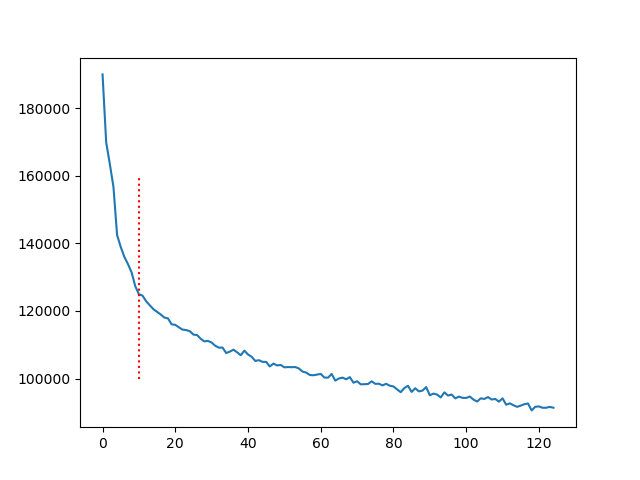

In [36]:
fig, ax = plt.subplots()
cluster_results.inertia.plot(ax=ax)
ax.vlines(x=clusters, ymin=100000, ymax=160000, colors='red', linestyles='dotted')

<IPython.core.display.Javascript object>


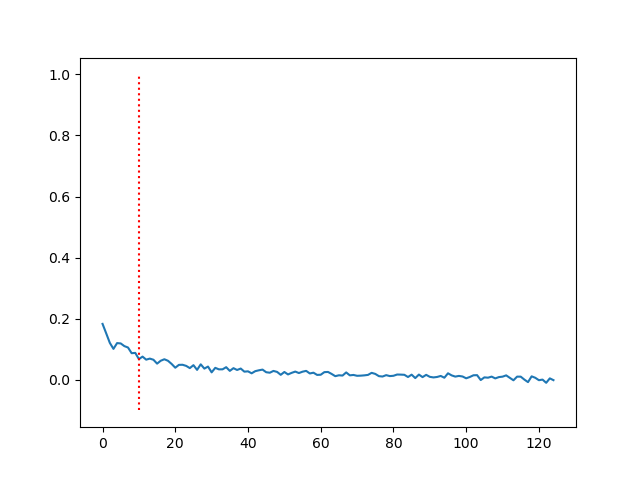

In [37]:
fig, ax = plt.subplots()

cluster_results.silhouette.plot()
ax.vlines(x=clusters, ymin=-.1, ymax=1, colors='red', linestyles='dotted')

In [8]:
genre_projected = latent_space.genres[latent_space.latent_cols].astype('float32')
kmeans_genre = MiniBatchKMeans(n_clusters=clusters).fit(genre_projected)
p = umap.plot.interactive(genre_map, labels = kmeans_genre.predict(genre_projected), point_size=10, hover_data=genre_hover_data)
umap.plot.show(p)

<IPython.core.display.Javascript object>


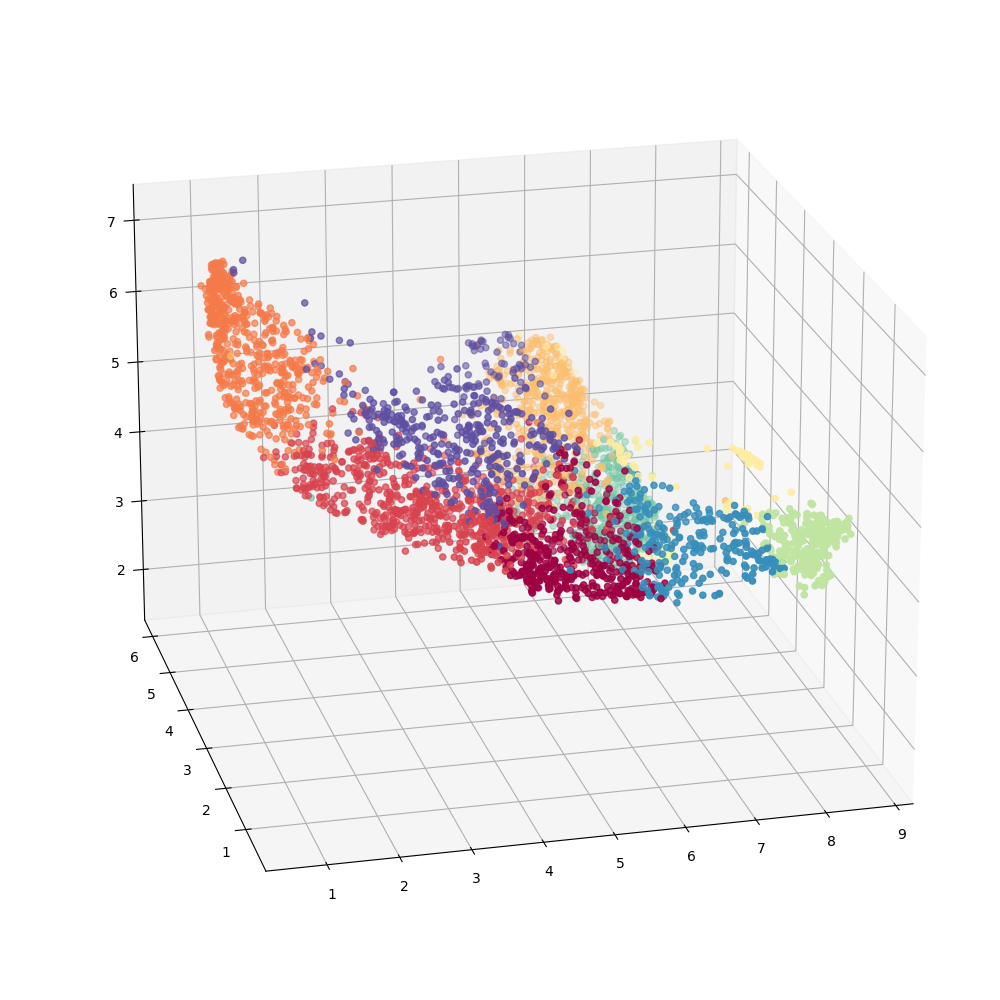

/var/folders/jy/34vkbxz97tbgm78bc07fmx380000gn/T/ipykernel_3729/2489030196.py:6: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


In [39]:
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D

genre_map_3d = umap.UMAP(n_components=3, n_neighbors=100, min_dist=.1).fit_transform(latent_space.genres[latent_space.latent_cols])
fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig)

ax.scatter(*genre_map_3d.T, c=kmeans_genre.predict(genre_projected), cmap='Spectral')

In [25]:
artists = latent_space.artists.copy().reset_index()
artist_genres = latent_space.tracks[['artist_name', 'artist_genres']].drop_duplicates(subset=['artist_name'])
artists = artists.merge(right=artist_genres, how='left', on='artist_name')
artist_latents = artists[latent_space.latent_cols]
artist_mapper = umap.UMAP(n_neighbors=60, min_dist=.5).fit(artist_latents)
artist_hover_data = artists[['artist_name','artist_genres']]
p = umap.plot.interactive(artist_mapper, labels=kmeans_genre.predict(artist_latents[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=artist_hover_data)
p.legend
umap.plot.show(p)

In [26]:
tracks_sample = latent_space.tracks.copy().sample(50000, random_state=42).reset_index()
mapper = umap.UMAP(n_neighbors=500, min_dist=.5).fit(tracks_sample[latent_space.latent_cols])

In [27]:
hover_data = tracks_sample[['artist_name','track_name','artist_genres']]
umap.plot.output_notebook()
p = umap.plot.interactive(mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

Loading BokehJS ...

In [28]:
time_latents = tracks_sample[latent_space.latent_cols[:128]]
time_mapper = umap.UMAP(n_neighbors=500, min_dist=.5).fit(time_latents)
p = umap.plot.interactive(time_mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

In [29]:
freq_latents = tracks_sample[latent_space.latent_cols[128:]]
freq_mapper = umap.UMAP(n_neighbors=500, min_dist=.5).fit(freq_latents)
p = umap.plot.interactive(freq_mapper, labels=kmeans_genre.predict(tracks_sample[latent_space.latent_cols].astype('float32')), point_size=2, hover_data=hover_data)
umap.plot.show(p)

<IPython.core.display.Javascript object>


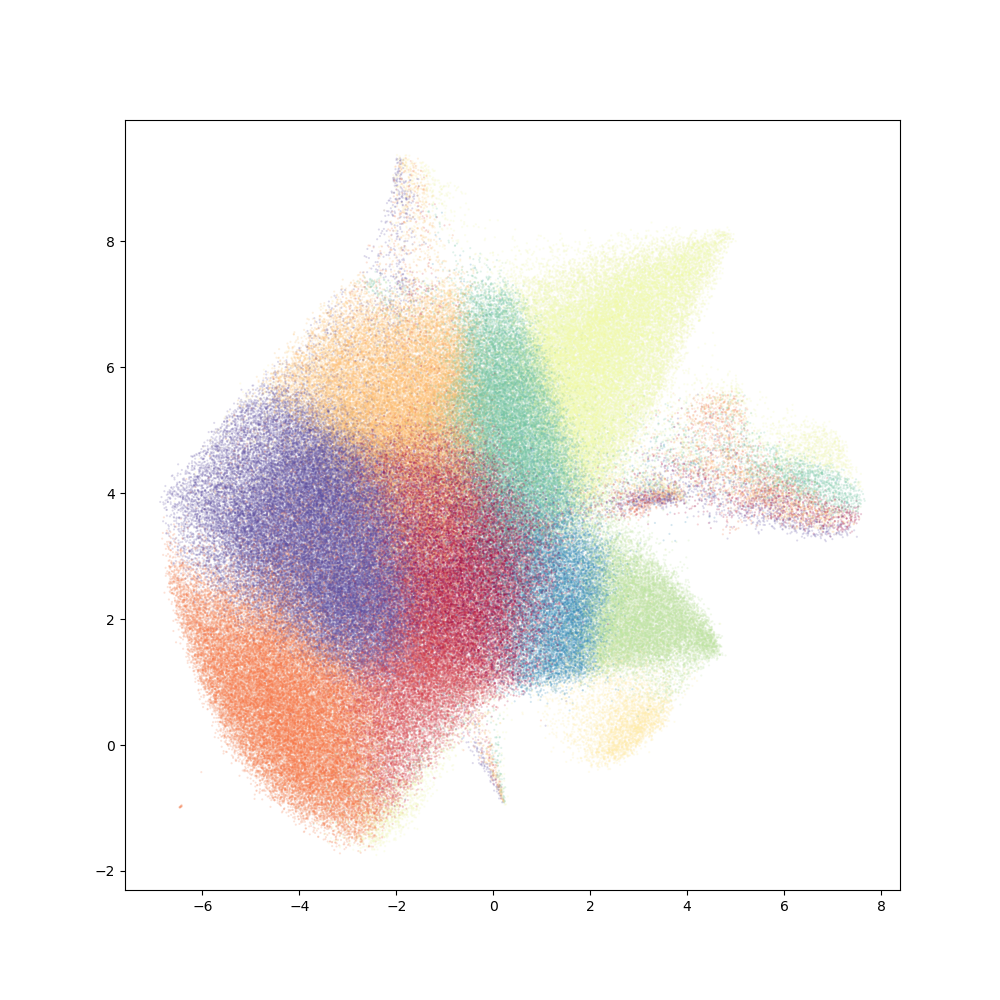

In [42]:
fig, ax = plt.subplots(1, figsize=(10, 10))
plt.scatter(*embedding.T, s=0.3, alpha=.2, c=kmeans_genre.predict(data), cmap='Spectral')

In [30]:
from sklearn.metrics.pairwise import cosine_similarity

mean_vector = latent_space.tracks[latent_space.latent_cols].mean()

similarity = cosine_similarity(np.array([mean_vector]), np.array(latent_space.tracks[latent_space.latent_cols]))

similarity_df = latent_space.tracks.copy()
similarity_df['similarity'] = similarity.T

most_similar = similarity_df.sort_values(by='similarity', ascending=False).reset_index()[:10]
most_similar[['track_uri','track_name','artist_name','artist_genres','similarity']]

NameError: name 'np' is not defined

In [ ]:
plt.figure(figsize=(20,5))
plt.imshow(np.array(most_similar[latent_space.latent_cols]),aspect=6)

In [11]:
latent_space.get_index_by_artist_name('Julee')

,track_id,track_name,artist_name
6439,0jF5G6LnVRX92gFTnKxIbx,Mysteries of Love,Julee Cruise
21099,7kOSSHSBmQ0Y0668lpUNV1,Rockin' Back Inside My Heart,Julee Cruise
143766,4F8MIfAJqa1Iit7ducjcLq,"Summer Kisses, Winter Tears",Julee Cruise
185587,0sE5llq6jkO2puFg8EHd2t,Into the Night,Julee Cruise
191833,55Wm3y6wUy5xS1thd0Zial,Floating,Julee Cruise
241201,3YB6eJ05SwjpL8G3zDeCpa,I Remember,Julee Cruise
255008,5kEcXZZS97TSNXc6174Ed6,The Nightingale,Julee Cruise


In [14]:
latent_space.get_similar_tracks_by_index(255008, scope='similar_artists')

,index,track_name,artist_name,track_uri,similarity
0,255008,The Nightingale,Julee Cruise,spotify:track:5kEcXZZS97TSNXc6174Ed6,1.000000
1,64428,Smoke Alarms,Sir Simon,spotify:track:5hchN9A5IecRG9oeUnokEF,0.686986
2,63800,I Will Follow You Into The Dark,Mipso,spotify:track:3Jmc6qadrwk3pg30iQPs5j,0.655864
3,90125,Blue Bayou,Linda Ronstadt,spotify:track:3zxklD2EGecZre9MjEEvIU,0.617888
4,190987,Andai Aku Bisa,Chrisye,spotify:track:4xDKLcFgljlQHCxSXS5BET,0.607931
5,105460,How Life Was Meant to Be Lived,Slow Dancing Society,spotify:track:4ODVnH3zaK2sai6Ckr8jNP,0.603335
6,209545,Bad with Faces,Sir Simon,spotify:track:79tfW2CMgXK5WSXdac4DxY,0.595446
7,18414,Wildflowers,Jadea Kelly,spotify:track:2JUrS0YbWk5vVYdOXQVcRv,0.594646
8,230680,50/50,Sylvie,spotify:track:551yHysiTdsHV8Vplt73Vc,0.589908
9,198115,Arrows,Missy Higgins,spotify:track:1lmEpe0TzDEhrLreYfX2Gz,0.578603
